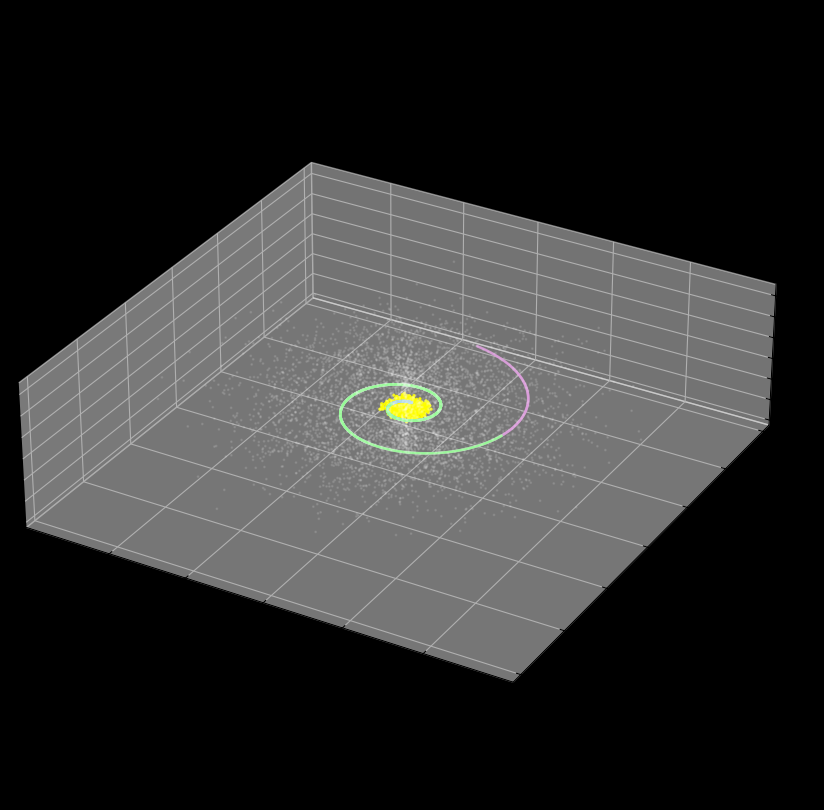

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def create_spiral_arm(start_angle, end_angle, b, z_scale=0.1):
    t = np.linspace(start_angle, end_angle, 1000)
    r = b * np.exp(0.2 * t)
    x = r * np.cos(t)
    y = r * np.sin(t)
    z = np.random.normal(0, z_scale, len(t)) * (r/r.max()) * z_scale
    return x, y, z

def create_bulge(n_points=1000):
    phi = np.random.uniform(0, 2*np.pi, n_points)
    theta = np.random.uniform(0, np.pi, n_points)
    r = np.random.normal(2, 0.5, n_points)
    
    x = r * np.sin(theta) * np.cos(phi)
    y = r * np.sin(theta) * np.sin(phi)
    z = r * np.cos(theta) * 0.6
    return x, y, z

def create_halo(n_points=5000):
    phi = np.random.uniform(0, 2*np.pi, n_points)
    theta = np.random.uniform(0, np.pi, n_points)
    r = np.random.normal(15, 5, n_points)
    
    x = r * np.sin(theta) * np.cos(phi)
    y = r * np.sin(theta) * np.sin(phi)
    z = r * np.cos(theta)
    return x, y, z

# Ana görselleştirme
plt.figure(figsize=(12, 10))
ax = plt.axes(projection='3d')

# Spiral kolları oluştur
spiral_params = [
    (0, 3*np.pi, 1),
    (np.pi/2, 3.5*np.pi, 1),
    (np.pi, 4*np.pi, 1),
    (3*np.pi/2, 4.5*np.pi, 1)
]

colors = ['#FFB6C1', '#ADD8E6', '#98FB98', '#DDA0DD']

for (start, end, b), color in zip(spiral_params, colors):
    x, y, z = create_spiral_arm(start, end, b)
    ax.scatter(x, y, z, c=color, alpha=0.6, s=1)

# Merkezi şişkinlik
x_bulge, y_bulge, z_bulge = create_bulge()
ax.scatter(x_bulge, y_bulge, z_bulge, c='yellow', alpha=0.8, s=2)

# Hale
x_halo, y_halo, z_halo = create_halo()
ax.scatter(x_halo, y_halo, z_halo, c='white', alpha=0.1, s=1)

# Görsel ayarları
ax.set_xlabel('X (kpc)')
ax.set_ylabel('Y (kpc)')
ax.set_zlabel('Z (kpc)')
ax.set_title('Samanyolu Galaksisi 3D Modeli')

# Eksenleri eşit ölçekle ayarla
ax.set_box_aspect([1,1,0.3])
ax.set_facecolor('black')
plt.gcf().patch.set_facecolor('black')

plt.show()

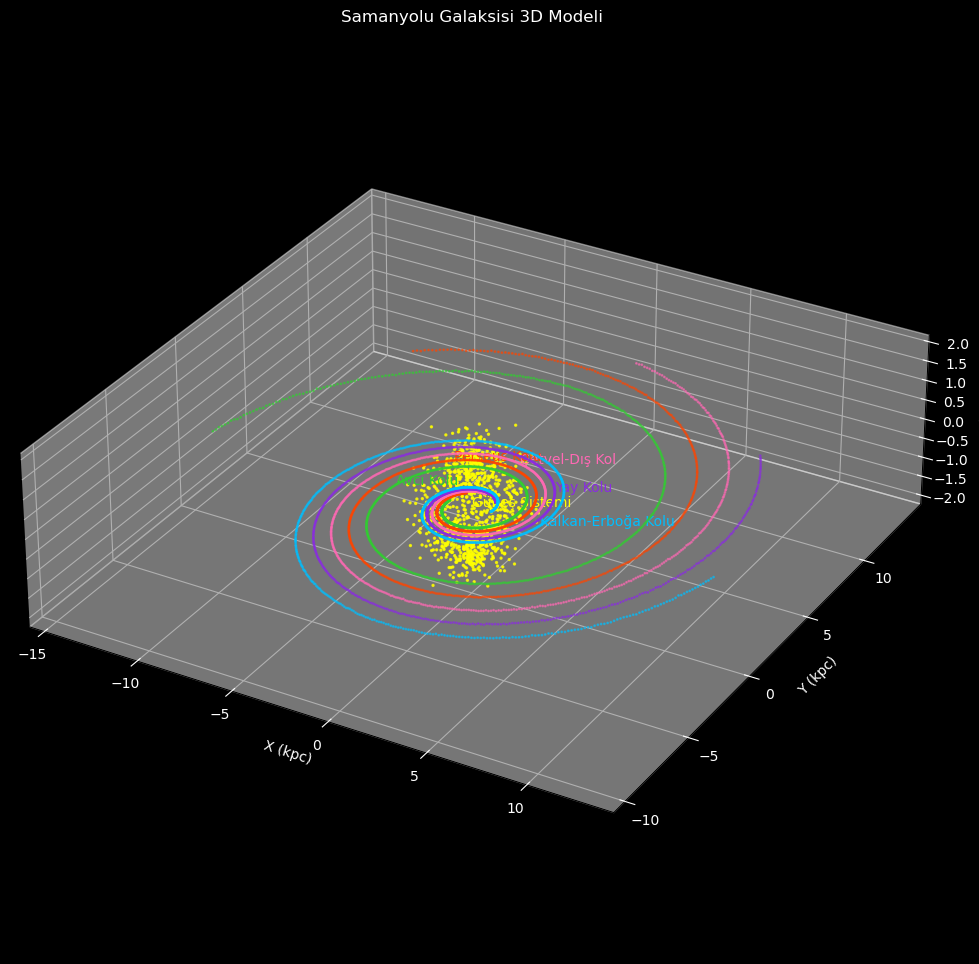

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def create_spiral_arm(start_angle, end_angle, b, z_scale=0.1, points=1000):
    t = np.linspace(start_angle, end_angle, points)
    r = b * np.exp(0.2 * t)
    x = r * np.cos(t)
    y = r * np.sin(t)
    z = np.random.normal(0, z_scale, len(t)) * (r/r.max()) * z_scale
    return x, y, z

def create_bulge(n_points=1000):
    phi = np.random.uniform(0, 2*np.pi, n_points)
    theta = np.random.uniform(0, np.pi, n_points)
    r = np.random.normal(2, 0.5, n_points)
    
    x = r * np.sin(theta) * np.cos(phi)
    y = r * np.sin(theta) * np.sin(phi)
    z = r * np.cos(theta) * 0.6
    return x, y, z

# Ana görselleştirme
plt.figure(figsize=(15, 12))
ax = plt.axes(projection='3d')

# Spiral kolları ve parametreleri
spiral_params = [
    ("Kalkan-Erboğa Kolu", 0, 4*np.pi, 1, '#00BFFF'),
    ("Yay Kolu", np.pi/4, 4.25*np.pi, 0.9, '#8A2BE2'),
    ("Çetvel-Dış Kol", np.pi/2, 4.5*np.pi, 0.8, '#FF69B4'),
    ("Perseus Kolu", 3*np.pi/4, 4.75*np.pi, 0.7, '#FF4500'),
    ("Avcı Kolu", np.pi, 5*np.pi, 0.6, '#32CD32')
]

# Spiral kolları oluştur ve etiketle
for name, start, end, b, color in spiral_params:
    x, y, z = create_spiral_arm(start, end, b)
    ax.scatter(x, y, z, c=color, alpha=0.6, s=1)
    
    # Etiket için orta nokta
    mid_point = len(x) // 2
    ax.text(x[mid_point], y[mid_point], z[mid_point], name, color=color)

# Merkezi şişkinlik
x_bulge, y_bulge, z_bulge = create_bulge()
ax.scatter(x_bulge, y_bulge, z_bulge, c='yellow', alpha=0.8, s=2)
ax.text(0, 0, 0, "Güneş Sistemi", color='yellow')

# Görsel ayarları
ax.set_xlabel('X (kpc)')
ax.set_ylabel('Y (kpc)')
ax.set_zlabel('Z (kpc)')
ax.set_title('Samanyolu Galaksisi 3D Modeli', color='white')

# Eksenleri eşit ölçekle ayarla
ax.set_box_aspect([1,1,0.3])
ax.set_facecolor('black')
plt.gcf().patch.set_facecolor('black')

# Eksen etiketlerini beyaz yap
ax.xaxis.label.set_color('white')
ax.yaxis.label.set_color('white')
ax.zaxis.label.set_color('white')
ax.tick_params(colors='white')

plt.show()

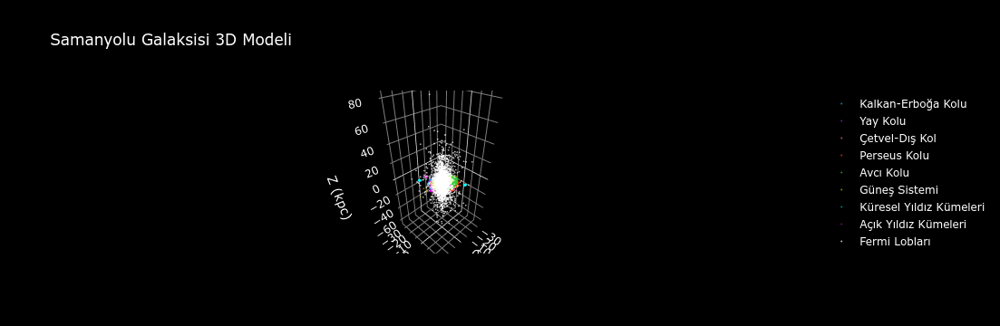

In [3]:
import numpy as np
import plotly.graph_objects as go

def create_realistic_spiral_arm(start_angle, end_angle, b, arm_width=0.5, z_scale=0.1, points=5000):
    t = np.linspace(start_angle, end_angle, points)
    r = b * np.exp(0.2 * t)
    width_variation = np.random.normal(0, arm_width, len(t))
    
    x_list, y_list, z_list = [], [], []
    
    for i in range(len(t)):
        n_points = int(max(5, 20 * (1 - i / len(t))))
        for _ in range(n_points):
            angle_var = np.random.normal(0, 0.1)
            r_var = abs(r[i] + width_variation[i] * np.random.normal(0, 1))
            x = r_var * np.cos(t[i] + angle_var)
            y = r_var * np.sin(t[i] + angle_var)
            z_scale_factor = z_scale * (r_var / (r.max() + 1e-10))
            z = np.random.normal(0, max(0.0001, z_scale_factor))
            
            x_list.append(x)
            y_list.append(y)
            z_list.append(z)
    
    return np.array(x_list), np.array(y_list), np.array(z_list)

def create_bar_bulge(n_points=10000):
    phi = np.random.uniform(0, 2 * np.pi, n_points)
    theta = np.random.uniform(0, np.pi, n_points)
    r = np.random.exponential(2, n_points)
    
    x = r * np.sin(theta) * np.cos(phi) * 1.5
    y = r * np.sin(theta) * np.sin(phi) * 0.5
    z = r * np.cos(theta) * 0.3
    return x, y, z

def create_star_clusters(n_clusters=5, cluster_size=100, disk_height=0.5, color='white'):
    x_list, y_list, z_list = [], [], []
    
    for _ in range(n_clusters):
        cluster_center = np.random.uniform(-20, 20, 2)
        cluster_z = np.random.uniform(-disk_height, disk_height)
        
        for _ in range(cluster_size):
            x = cluster_center[0] + np.random.normal(0, 0.5)
            y = cluster_center[1] + np.random.normal(0, 0.5)
            z = cluster_z + np.random.normal(0, 0.1)
            
            x_list.append(x)
            y_list.append(y)
            z_list.append(z)
    
    return np.array(x_list), np.array(y_list), np.array(z_list), color

def create_fermi_lobes(n_points=5000, height=10, width=5):
    phi = np.random.uniform(0, 2 * np.pi, n_points)
    theta = np.random.uniform(0, np.pi, n_points)
    r = np.random.exponential(1, n_points)
    
    x = r * np.sin(theta) * np.cos(phi) * width
    y = r * np.sin(theta) * np.sin(phi) * width
    z = r * np.cos(theta) * height
    return x, y, z

# Spiral kolları ve parametreleri
spiral_params = [
    ("Kalkan-Erboğa Kolu", 0, 4 * np.pi, 1, 'deepskyblue'),
    ("Yay Kolu", np.pi / 4, 4.25 * np.pi, 0.9, 'blueviolet'),
    ("Çetvel-Dış Kol", np.pi / 2, 4.5 * np.pi, 0.8, 'hotpink'),
    ("Perseus Kolu", 3 * np.pi / 4, 4.75 * np.pi, 0.7, 'orangered'),
    ("Avcı Kolu", np.pi, 5 * np.pi, 0.6, 'limegreen')
]

fig = go.Figure()

# Spiral kolları oluştur ve etiketle
for name, start, end, b, color in spiral_params:
    x, y, z = create_realistic_spiral_arm(start, end, b, arm_width=0.7)
    fig.add_trace(go.Scatter3d(
        x=x, y=y, z=z, mode='markers',
        marker=dict(size=1, color=color, opacity=0.7),
        name=name
    ))

# Merkezi bar şişkinliği
x_bar, y_bar, z_bar = create_bar_bulge()
fig.add_trace(go.Scatter3d(
    x=x_bar, y=y_bar, z=z_bar, mode='markers',
    marker=dict(size=1, color='yellow', opacity=0.5),
    name='Güneş Sistemi'
))

# Küresel ve açık yıldız kümeleri
x_clusters, y_clusters, z_clusters, color = create_star_clusters(color='cyan')
fig.add_trace(go.Scatter3d(
    x=x_clusters, y=y_clusters, z=z_clusters, mode='markers',
    marker=dict(size=1, color=color, opacity=0.5),
    name='Küresel Yıldız Kümeleri'
))

x_clusters, y_clusters, z_clusters, color = create_star_clusters(color='magenta')
fig.add_trace(go.Scatter3d(
    x=x_clusters, y=y_clusters, z=z_clusters, mode='markers',
    marker=dict(size=1, color=color, opacity=0.5),
    name='Açık Yıldız Kümeleri'
))

# Fermi lobları
x_lobes, y_lobes, z_lobes = create_fermi_lobes()
fig.add_trace(go.Scatter3d(
    x=x_lobes, y=y_lobes, z=z_lobes, mode='markers',
    marker=dict(size=1, color='white', opacity=0.7),
    name='Fermi Lobları'
))

# Görsel ayarları
fig.update_layout(
    title='Samanyolu Galaksisi 3D Modeli',
    scene=dict(
        xaxis_title='X (kpc)',
        yaxis_title='Y (kpc)',
        zaxis_title='Z (kpc)',
        xaxis=dict(backgroundcolor='black', color='white', gridcolor='gray'),
        yaxis=dict(backgroundcolor='black', color='white', gridcolor='gray'),
        zaxis=dict(backgroundcolor='black', color='white', gridcolor='gray')
    ),
    paper_bgcolor='black',
    font=dict(color='white')
)

fig.show()


yukarıdaki galaksi modelini daha gerçekçi yapmak için bazı güncellemeler yapmalıyız: 

1. spiral kollar aynı noktadan başlamasın barın kısa kenarlarından başlasınlar arasında boşluk olmalı ayırt edilebilir olmalılar (lütfen boşluk bırak)

3. bulge kısmını biraz daha bar şeklinde ayarlayalım

4. disk düzlemine yakın küresel kümeleri ve disk düzleminin üstünde (belirli bir miktar altında ve üstünde bulunabilir) bulunan açık yıldız kümelerini oluşturmalıyız bu iki yıldız kümesine farklı kullanılmamış renkler ata ve etiket olarak belirt çok fazla oluşturmana gerek yok 5-6 tane oluştursan yeterli (yandan bakıldığında disk üzeirndeki ve disk içindeki kümeler ayırt edilebilir olsun).

5. bulge kısmının altına ve üstüne fermi lobları yerleştirmemiz gerekiyor 3 boyutlu eliptik bir yapı oluştur (katı bir disk gibi noktalardan değil bir bulut gibi) ve bu yapıyı biraz şefaf yap.

bu güncellemeleri yapabilir misin plotly kütüphanesini kullanmaya devam et, lütfen yapıtğın güncellemelerini yorum satırı olarak belirt